In [19]:
import module1
from importlib import reload
import random
reload(module1)

def run_experiment(ca_modifier):
    ca = module1.CellularAutomata(
        img_size=20, 
        channel_count=9,
        layer_counts=[128],
        perception_kernel=module1.sobel_state_kernel())
    ca.noise_range = (0, 0) #(-0.1, 0.1)
    ca.conserve_mass = False
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    
    ca_modifier(ca)

    training = module1.init_training(ca, learning_rate=1.5e-3)

    x0 = lambda: ca.constfilled(1.0)
    xf = lambda: ca.imagefilled("lenna.png")

    for i in range(3):
        training.run(x0, xf, 32, max_seconds=20, use_feedback=False)
        training.show_sample_run(x0, xf, 32)
        training.show_loss_history()

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d (Conv2D)              (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


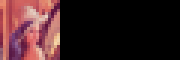

Sample run:


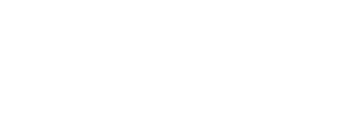


 step: 227, loss: 0.007, log10(loss): -2.152

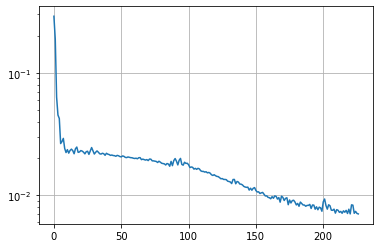

Stopping due to time-out
Target:


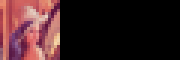

Sample run:


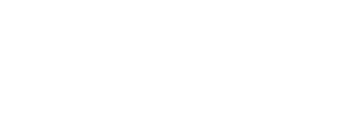


 step: 486, loss: 0.003, log10(loss): -2.538

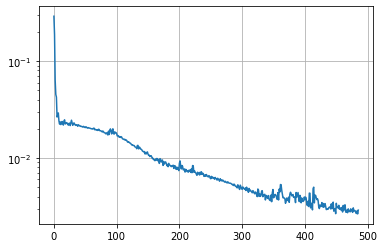

Stopping due to time-out
Target:


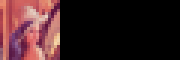

Sample run:


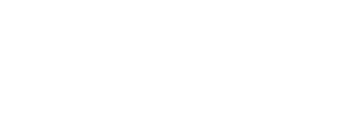


 step: 745, loss: 0.002, log10(loss): -2.797

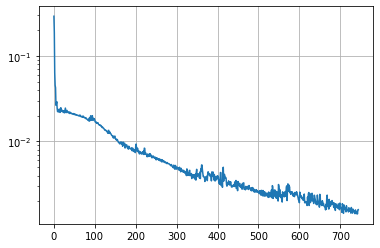

In [2]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.ZEROS
run_experiment(exp)

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


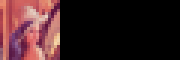

Sample run:


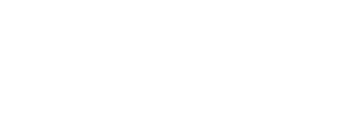


 step: 240, loss: 0.006, log10(loss): -2.243

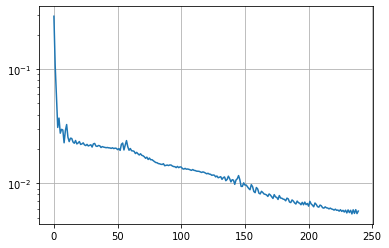

Stopping due to time-out
Target:


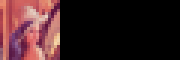

Sample run:


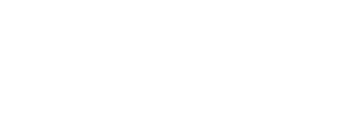


 step: 499, loss: 0.003, log10(loss): -2.585

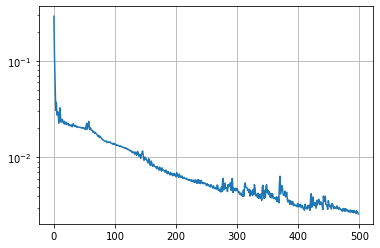

Stopping due to time-out
Target:


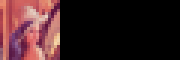

Sample run:


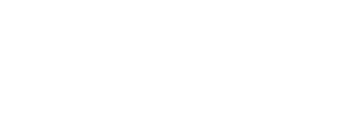


 step: 759, loss: 0.002, log10(loss): -2.715

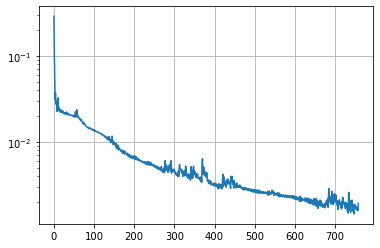

In [3]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.ONES
run_experiment(exp)

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_4 (Conv2D)            (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_5 (Conv2D)            (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


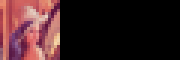

Sample run:


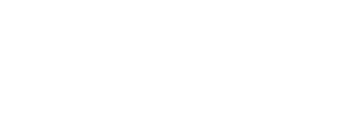


 step: 189, loss: 0.022, log10(loss): -1.651

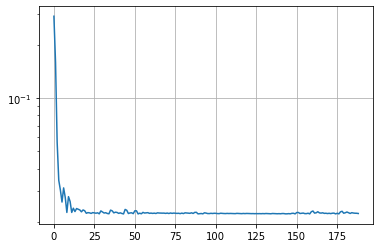

Stopping due to time-out
Target:


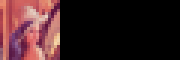

Sample run:


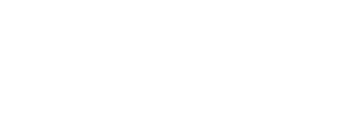


 step: 436, loss: 0.022, log10(loss): -1.654

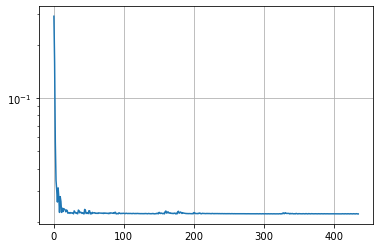

Stopping due to time-out
Target:


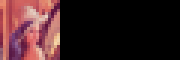

Sample run:


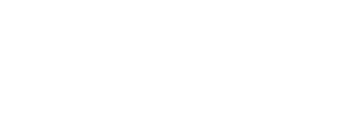


 step: 687, loss: 0.022, log10(loss): -1.653

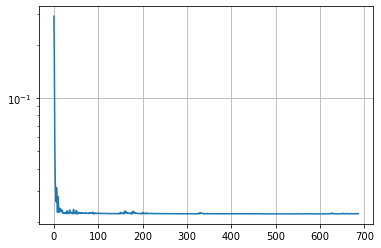

In [4]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
run_experiment(exp)

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_6 (Conv2D)            (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


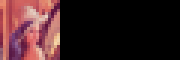

Sample run:


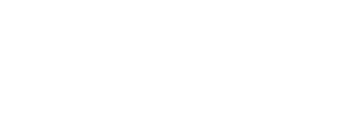


 step: 209, loss: 0.022, log10(loss): -1.651

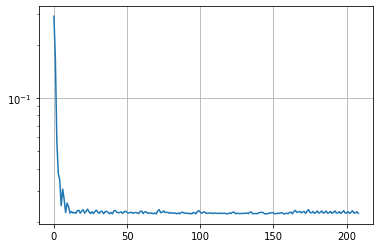

Stopping due to time-out
Target:


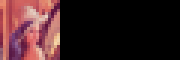

Sample run:


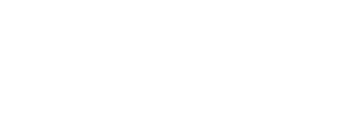


 step: 436, loss: 0.023, log10(loss): -1.644

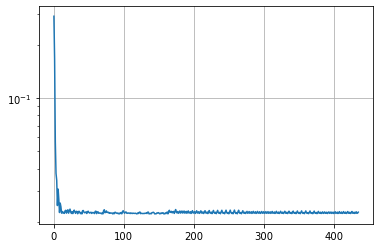

Stopping due to time-out
Target:


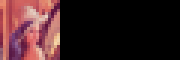

Sample run:


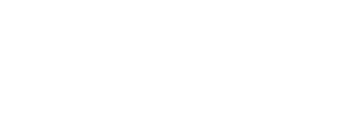


 step: 656, loss: 0.022, log10(loss): -1.651

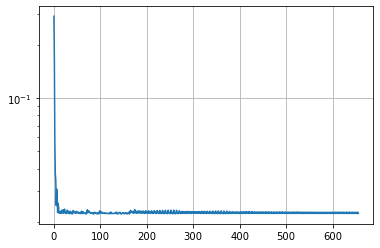

In [5]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.TORUS
run_experiment(exp)

Model: "model_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


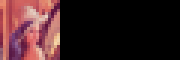

Sample run:


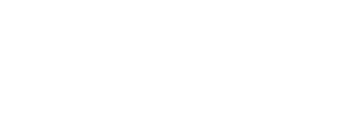


 step: 242, loss: 0.007, log10(loss): -2.158

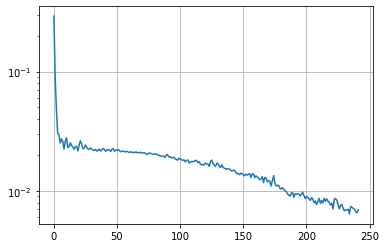

Stopping due to time-out
Target:


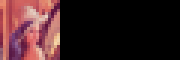

Sample run:


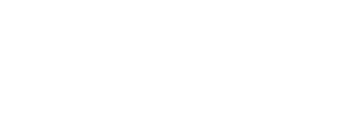


 step: 509, loss: 0.003, log10(loss): -2.488

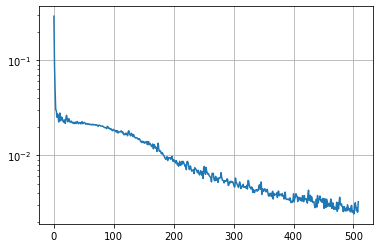

Stopping due to time-out
Target:


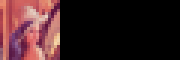

Sample run:


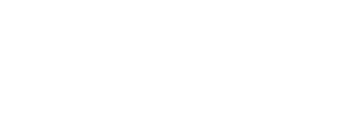


 step: 778, loss: 0.002, log10(loss): -2.785

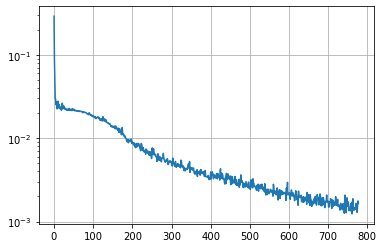

In [6]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.RANDOM
run_experiment(exp)

Model: "model_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


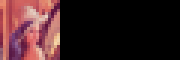

Sample run:


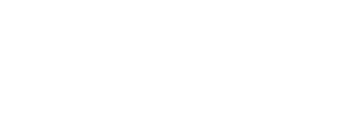


 step: 236, loss: 0.007, log10(loss): -2.142

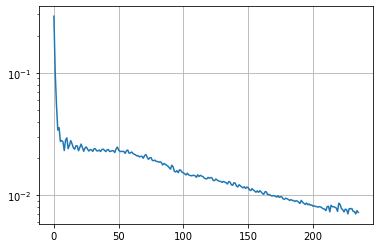

Stopping due to time-out
Target:


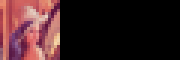

Sample run:


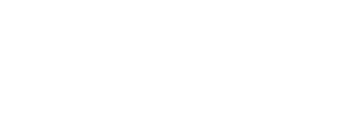


 step: 484, loss: 0.004, log10(loss): -2.412

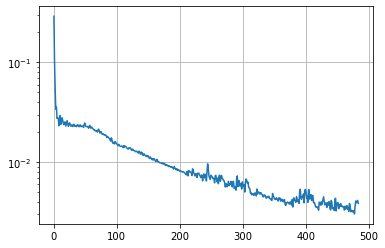

Stopping due to time-out
Target:


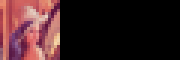

Sample run:


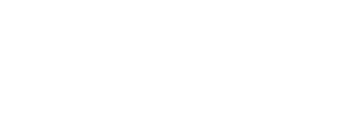


 step: 739, loss: 0.003, log10(loss): -2.521

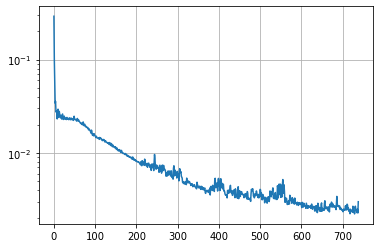

In [7]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.pointfilled(ca.constfilled(1.0), point_value=0.0)
run_experiment(exp)

Model: "model_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


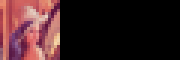

Sample run:


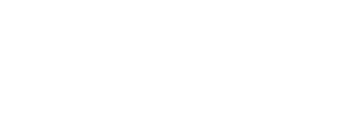


 step: 227, loss: 0.016, log10(loss): -1.806

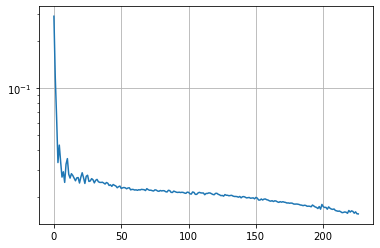

Stopping due to time-out
Target:


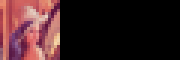

Sample run:


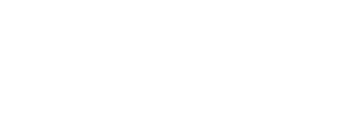


 step: 486, loss: 0.008, log10(loss): -2.094

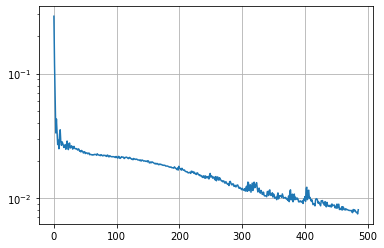

Stopping due to time-out
Target:


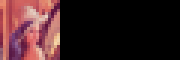

Sample run:


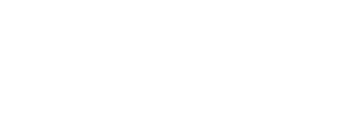


 step: 746, loss: 0.006, log10(loss): -2.211

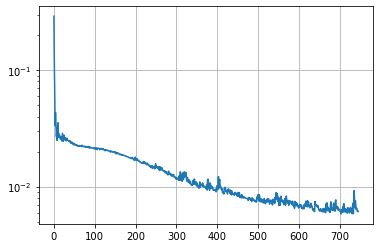

In [8]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.pointsfilled(ca.constfilled(1.0), point_value=0.0, positions=[(1/3,1/3), (2/3,1/3), (1/3,2/3), (2/3,2/3)])
run_experiment(exp)

Model: "model_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_14 (InputLayer)        [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_26 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_27 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


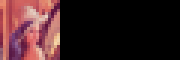

Sample run:


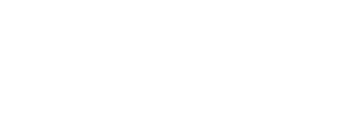


 step: 215, loss: 0.029, log10(loss): -1.542

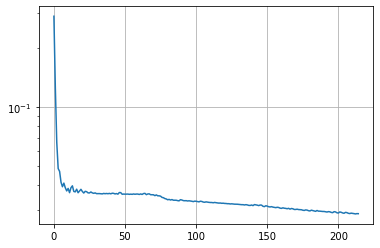

Stopping due to time-out
Target:


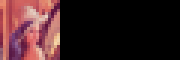

Sample run:


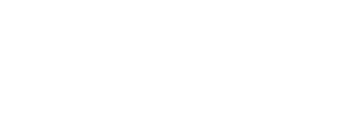


 step: 470, loss: 0.024, log10(loss): -1.620

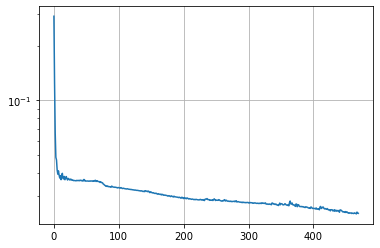

Stopping due to time-out
Target:


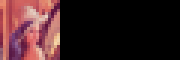

Sample run:


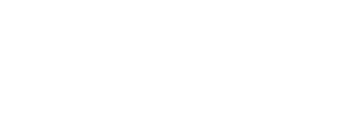


 step: 726, loss: 0.020, log10(loss): -1.691

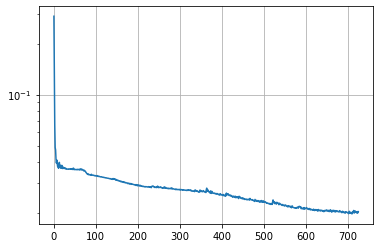

In [20]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.linefilled(ca.constfilled(1.0), line_value=0.0, a=(0,0), b=(1,1))
run_experiment(exp)

Model: "model_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_15 (InputLayer)        [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_28 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_29 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


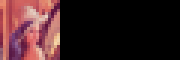

Sample run:


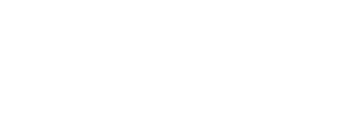


 step: 232, loss: 0.013, log10(loss): -1.870

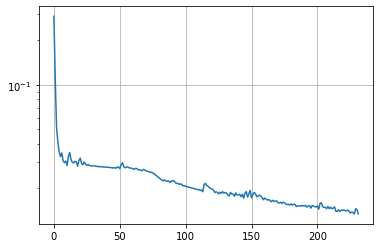

Stopping due to time-out
Target:


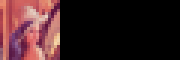

Sample run:


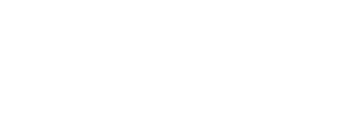


 step: 494, loss: 0.010, log10(loss): -2.020

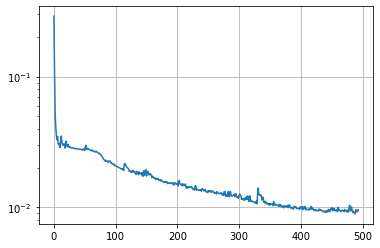

Stopping due to time-out
Target:


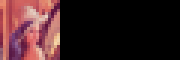

Sample run:


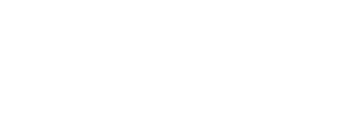


 step: 757, loss: 0.008, log10(loss): -2.093

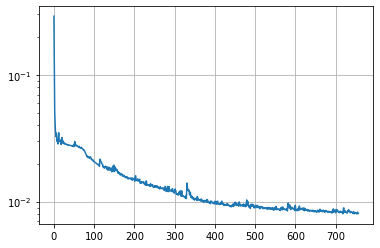

In [21]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.linefilled(ca.constfilled(1.0), line_value=0.0, a=(1/2,1/3), b=(1/2,2/3))
run_experiment(exp)

Model: "model_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_16 (InputLayer)        [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_30 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_31 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


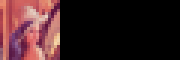

Sample run:


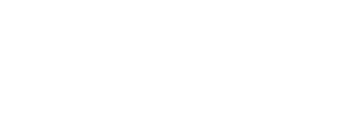


 step: 224, loss: 0.049, log10(loss): -1.313

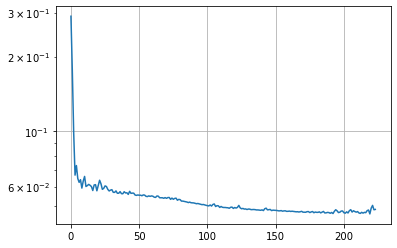

Stopping due to time-out
Target:


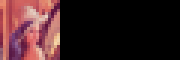

Sample run:


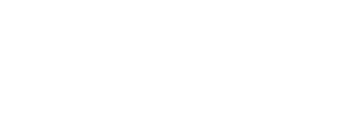


 step: 486, loss: 0.044, log10(loss): -1.361

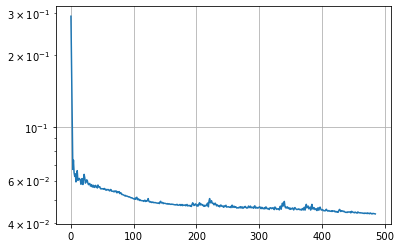

Stopping due to time-out
Target:


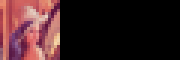

Sample run:


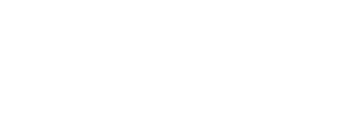


 step: 739, loss: 0.042, log10(loss): -1.378

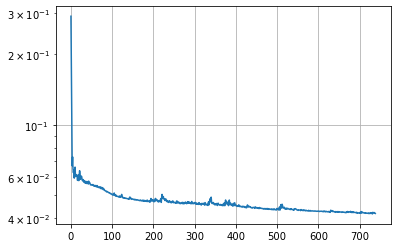

In [23]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.linefilled(ca.linefilled(ca.constfilled(1.0), 
        line_value=0.0, a=(0,0), b=(1,1)),
        line_value=0.0, a=(1,0), b=(0,1))
run_experiment(exp)

Model: "model_17"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_18 (InputLayer)        [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_34 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_35 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


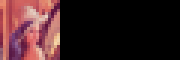

Sample run:


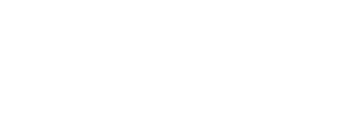


 step: 235, loss: 0.041, log10(loss): -1.385

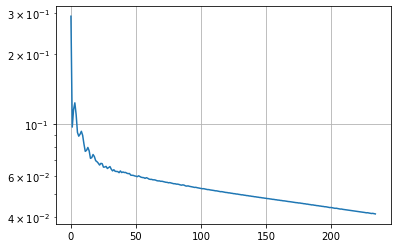

Stopping due to time-out
Target:


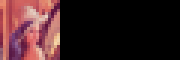

Sample run:


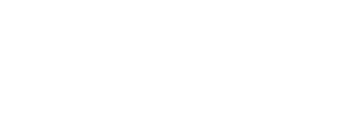


 step: 486, loss: 0.033, log10(loss): -1.481

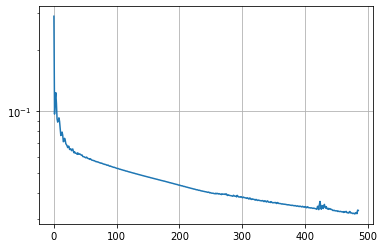

Stopping due to time-out
Target:


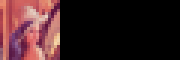

Sample run:


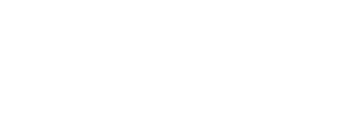


 step: 741, loss: 0.030, log10(loss): -1.526

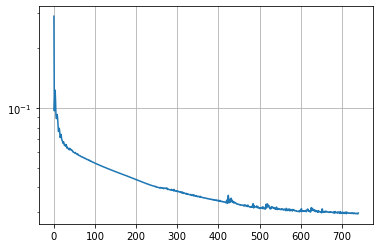

In [25]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.imagefilled("earth.png")
run_experiment(exp)

Model: "model_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_24 (InputLayer)        [(None, 20, 20, 27)]      0         
_________________________________________________________________
conv2d_46 (Conv2D)           (None, 20, 20, 128)       3584      
_________________________________________________________________
conv2d_47 (Conv2D)           (None, 20, 20, 9)         1161      
Total params: 4,745
Trainable params: 4,745
Non-trainable params: 0
_________________________________________________________________
Stopping due to time-out
Target:


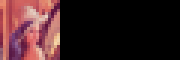

Sample run:


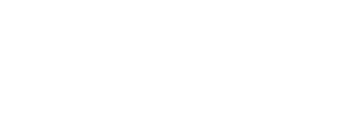


 step: 242, loss: 0.150, log10(loss): -0.823

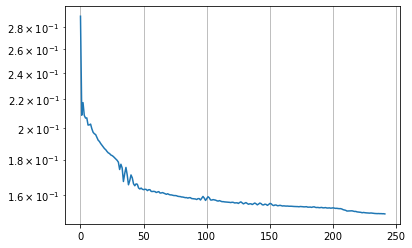

Stopping due to time-out
Target:


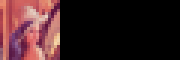

Sample run:


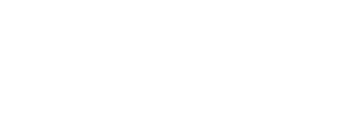


 step: 493, loss: 0.149, log10(loss): -0.828

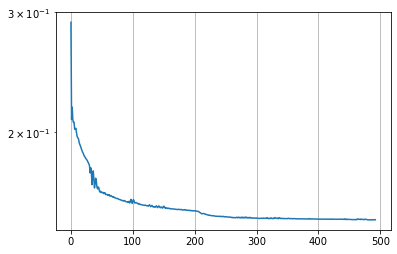

Stopping due to time-out
Target:


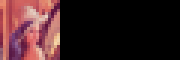

Sample run:


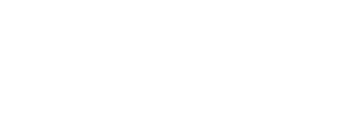


 step: 747, loss: 0.148, log10(loss): -0.831

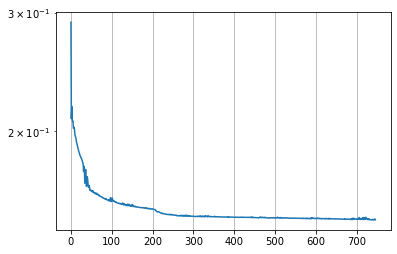

In [31]:
def exp(ca):
    ca.edge_strategy = module1.EdgeStrategy.MIRROR
    ca.value_weight_map = ca.imagefilled("mandelbrot.png")
run_experiment(exp)